# Final Project 

First we will go through and do an unsupervised and semi-supervised analysis on the RNA data. This will be done on combined patients so that we can have a higher statistical power. 

In [1]:
# load modules
import os
import sys
import gzip
import numpy as np
import scipy.stats as stats
import pandas as pd
import pickle
import anndata
import scanpy
import scipy
import phenograph # install from https://github.com/jacoblevine/PhenoGraph
import collections
from scipy.io import mmread,mminfo
from sklearn.decomposition import PCA

# Plotting imports
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
def graph_patients(df_list, names_list, xrange=None):
    fig = plt.figure(figsize=[4 * len(df_list), 4])
    for i, sample in enumerate(df_list):
        ms = np.log10(sample.sum(axis=1)) #library size
        # Figure
        ax = fig.add_subplot(1, len(df_list), i+1)
        ax.hist(ms,50,xrange)
        ax.set_title(names_list[i])
        ax.set_xlabel('log10 of library size')

In [3]:
def cell_filter(threshold, sample):
    ms = sample.sum(axis = 1) #library size 
    use_cells = ms.index[np.log10(ms) > threshold]
    sample = sample.loc[use_cells]
    print(sample.shape)
    return sample

In [4]:
def gene_filter(sample,threshold=0):
    before = sample.shape[1]
    use_genes = sample.columns[sample.sum(axis=0) > threshold]
    sample = sample[use_genes]
    print(before - sample.shape[1] , "genes removed")
    return sample

## Loading Files

In [5]:
path="/Users/lauren_friend/Desktop/AziziLab/visium"

#patient 2A
patient_2A_path = f"{path}/Patient2A_021120_IGO_10778_3/outs"
patient_2A_filtered_path = f"{patient_2A_path}/filtered_feature_bc_matrix"
#patient 2B
patient_2B_path = f"{path}/Patient2B_021120_IGO_10778_4/outs"
patient_2B_filtered_path = f"{patient_2B_path}/filtered_feature_bc_matrix"

### 2A

In [6]:
with gzip.open(f"{patient_2A_filtered_path}/barcodes.tsv.gz",mode="rb") as f:
    barcodes_2A = pd.read_csv(f, sep='\t', names=['barcode'])
with gzip.open(f"{patient_2A_filtered_path}/features.tsv.gz",mode="rb") as f:
    features_2A = pd.read_csv(f, sep='\t',names=['geneID','gene_name','type'])
with gzip.open(f"{patient_2A_filtered_path}/matrix.mtx.gz",mode="rb") as f:
    matrix_2A = mmread(f)
    
print(features_2A.shape)
print(barcodes_2A.shape)
print(matrix_2A.shape)

#transposing matrix to cellsxgenes
matrix_2A_transpose = matrix_2A.transpose()
#creating anndata object 
ad_2A = anndata.AnnData(X=matrix_2A_transpose,obs=barcodes_2A,var=features_2A)
#creating dataframe
matrix_2A_transpose_dense=matrix_2A_transpose.todense()
df_2A = pd.DataFrame(matrix_2A_transpose_dense,columns=[x for x in features_2A['gene_name']])
df_2A.index = [f'A_{i}' for i in df_2A.index]

(36601, 3)
(3245, 1)
(36601, 3245)


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/anndata/_core/anndata.py:119: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


### 2B

In [7]:
with gzip.open(f"{patient_2B_filtered_path}/barcodes.tsv.gz",mode="rb") as f:
    barcodes_2B = pd.read_csv(f, sep='\t', names=['barcode'])
with gzip.open(f"{patient_2B_filtered_path}/features.tsv.gz",mode="rb") as f:
    features_2B = pd.read_csv(f, sep='\t',names=['geneID','gene_name','type'])
with gzip.open(f"{patient_2B_filtered_path}/matrix.mtx.gz",mode="rb") as f:
    matrix_2B = mmread(f)
    
print(features_2B.shape)
print(barcodes_2B.shape)
print(matrix_2B.shape)

#transposing matrix to cellsxgenes
matrix_2B_transpose = matrix_2B.transpose()
#creating anndata object 
ad_2B = anndata.AnnData(X=matrix_2B_transpose,obs=barcodes_2B,var=features_2B)
#creating dataframe
matrix_2B_transpose_dense=matrix_2B_transpose.todense()
df_2B = pd.DataFrame(matrix_2B_transpose_dense,columns=[x for x in features_2B['gene_name']])
df_2B.index = [f'B_{i}' for i in df_2B.index]

(36601, 3)
(3201, 1)
(36601, 3201)


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/anndata/_core/anndata.py:119: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [8]:
print(len(barcodes_2A) + len(barcodes_2B))
print(len(set([x for x in barcodes_2B['barcode']]+ [x for x in barcodes_2A['barcode']])))
print(len(set(barcodes_2B['barcode']+barcodes_2A['barcode'])))

6446
3631
3202


there is not a unique set of barcodes, so the 2 patients cannot be indexed by barcode alone

## Filter and Normalize

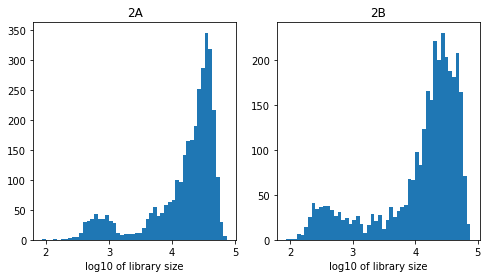

In [9]:
names = ['2A','2B']
dataframes = [df_2A,df_2B]

graph_patients(dataframes,names)

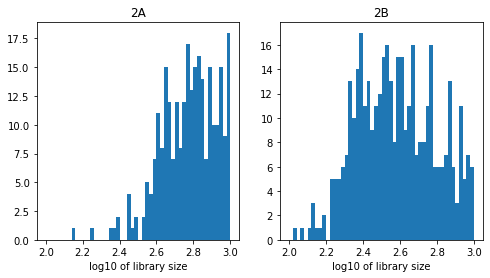

In [10]:
names = ['2A','2B']
dataframes = [df_2A,df_2B]

graph_patients(dataframes,names,(2,3))

In [11]:
df_2A = cell_filter(2.6,df_2A)
df_2B = cell_filter(2.3,df_2B)
df2 = pd.concat([df_2A,df_2B])

(3213, 36601)
(3169, 36601)


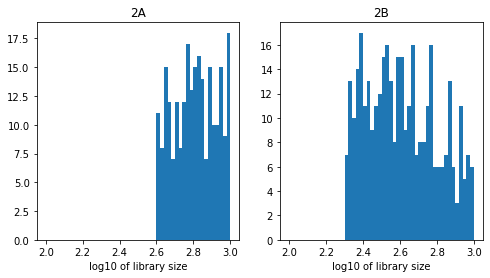

In [12]:
names = ['2A','2B']
dataframes = [df_2A,df_2B]

graph_patients(dataframes,names,(2,3))

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


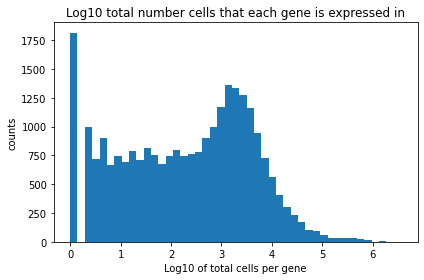

In [13]:
counts_log10 = np.log10(df2.sum(axis=0))
plt.hist(counts_log10,bins='auto', range=(0,counts_log10.max()))
plt.title('Log10 total number cells that each gene is expressed in')
plt.xlabel('Log10 of total cells per gene')
plt.ylabel('counts')
plt.tight_layout()

In [14]:
df2 = gene_filter(df2,3)

14009 genes removed


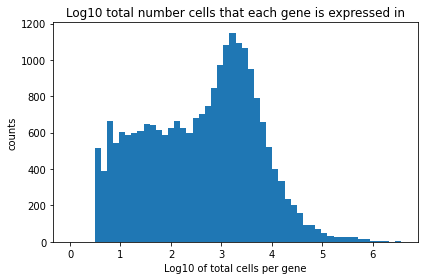

In [15]:
counts_log10 = np.log10(df2.sum(axis=0))
plt.hist(counts_log10,bins='auto', range=(0,counts_log10.max()))
plt.title('Log10 total number cells that each gene is expressed in')
plt.xlabel('Log10 of total cells per gene')
plt.ylabel('counts')
plt.tight_layout()

In [16]:
df2.shape

(6382, 22592)

In [17]:
#filter out genes that are noisy 
ribosomal_genes = [x for x in df2.columns.values if x[:2]=='RP']
#mitochondrial_genes = [x for x in df2.columns.values if x[:3]=='MT-']
df2 = df2.drop(columns= ribosomal_genes)

In [18]:
df2.shape

(6382, 22452)

In [26]:
#normalize
ms = df2.sum(axis=1) #library size
norm_df = df2.div(ms, axis=0).mul(np.median(ms), axis=0)
log_norm_df = np.log(0.1+ norm_df)

## Create an AnnData Compatable representation of the Log Normalized DF

In [20]:
bA= barcodes_2A
bA.index=[f'A_{i}' for i in bA.index]

bB=barcodes_2B
bB.index=[f'B_{i}' for i in bB.index]

barcodes = pd.concat([bA,bB])

In [21]:
log_norm_df_test = log_norm_df

In [22]:
barcodes.loc[log_norm_df_test.index.values].head(3)

,barcode
A_0,AAACAATCTACTAGCA-1
A_1,AAACACCAATAACTGC-1
A_2,AAACAGCTTTCAGAAG-1


In [23]:
#change the index of this DF to be AnnData compatible
log_norm_df_test.index=barcodes.loc[log_norm_df_test.index]
log_norm_df_test.index=[x[0] for x in log_norm_df_test.index]

In [28]:
print(log_norm_df_test.shape)
log_norm_df_test.head(3)

(6382, 22452)


,AL627309.1,AL627309.5,AP006222.2,AL732372.1,AC114498.1,AL669831.2,LINC01409,FAM87B,LINC01128,LINC00115,...,MT-ND6,MT-CYB,BX004987.1,AC145212.1,MAFIP,AC011043.1,AL354822.1,AL592183.1,AC240274.1,AC007325.4
AAACAATCTACTAGCA-1,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,4.006348,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
AAACACCAATAACTGC-1,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-0.467011,...,-2.302585,3.768236,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
AAACAGCTTTCAGAAG-1,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,2.285718,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585


In [27]:
log_norm_df.head(3)

,AL627309.1,AL627309.5,AP006222.2,AL732372.1,AC114498.1,AL669831.2,LINC01409,FAM87B,LINC01128,LINC00115,...,MT-ND6,MT-CYB,BX004987.1,AC145212.1,MAFIP,AC011043.1,AL354822.1,AL592183.1,AC240274.1,AC007325.4
A_0,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,4.006348,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
A_1,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-0.467011,...,-2.302585,3.768236,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
A_2,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,2.285718,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585


## Dimentionality Reduction 

In [29]:
pca= PCA(n_components=15) #15 taken from elbo plot
pca_projections = pd.DataFrame(pca.fit_transform(log_norm_df),
                index=log_norm_df.index)

## Visualization

set of dimensionality reduction tools to explore the data in groupings or in the trajectory

In [30]:
import umap
def perform_umap(pca_dataframe,log_df,neighbors=15): #15-50 neighbors
    reducer = umap.UMAP(n_neighbors=neighbors)
    embedding = pd.DataFrame(reducer.fit_transform(pca_dataframe),columns=['x','y'],index=log_df.index)
    return embedding

def graph_umap(raw_df,norm_df,umap_output,title):
    ms=raw_df.sum(axis=1)
    plt.figure(figsize=[5, 3.5])
    plt.scatter(umap_output['x'],umap_output['y'],s=5, edgecolors='none',
        cmap=matplotlib.cm.Spectral_r, c=np.log10(ms[norm_df.index]))
    plt.title(f'{title} UMAP colored by log 10 of expression')
    plt.colorbar()

In [31]:
import bhtsne
def perform_tsne(num_PC,pca_projections, perplexity, log_df):
    use_eigs = list(range(1, num_PC))
    data = pca_projections.values[:, use_eigs] 
    # tsNE
    tsne = pd.DataFrame(bhtsne.tsne(data, perplexity=perplexity), 
                index=log_df.index, columns=['x', 'y'])
    return tsne

def graph_tsne(raw_df,norm_df,tsne,title):
    ms = raw_df.sum(axis=1)
    plt.figure(figsize=[5, 3.5])
    plt.scatter(tsne['x'], tsne['y'], s=5, edgecolors='none',
        cmap=matplotlib.cm.Spectral_r, c=np.log10(ms[norm_df.index]))
    plt.title(f'{title} tSNE colored by log 10 of expression')
    plt.colorbar()

In [32]:
def side_by_side(tsne,umap,raw_df,norm_df,title):
    ms=raw_df.sum(axis=1)
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 4))
    #umap
    plot1=ax[0].scatter(umap['x'],umap['y'],s=5, edgecolors='none', cmap=matplotlib.cm.Spectral_r, c=np.log10(ms[norm_df.index]))
    ax[0].set_title(f"UMAP of {title}")
    fig.colorbar(plot1,ax=ax[0])
    #tsne
    plot2=ax[1].scatter(tsne['x'], tsne['y'], s=5, edgecolors='none', cmap=matplotlib.cm.Spectral_r, c=np.log10(ms[norm_df.index]))
    ax[1].set_title(f"tSNE of {title}")
    fig.colorbar(plot2,ax=ax[1])

In [33]:
def plot_genes_umap(genes_list, umap, log_df, title):
    # Set up figure grid
    unexpressed=[]
    n = len(genes_list); max_cols = 4
    nrows = int(np.ceil(n / max_cols)); ncols = int(min((max_cols, n)))
    
    fig = plt.figure(figsize=[5 * ncols, 4*nrows])
    for i, gene in enumerate(genes_list):
        try:
            ax = fig.add_subplot(nrows, ncols, i+1)
            plot = ax.scatter(umap['x'],umap['y'],s=5, edgecolors='none',
                    cmap=matplotlib.cm.Spectral_r, c=log_df.loc[pd.DataFrame(umap,index=log_df.index).index, gene],
                              label=gene)
            fig.colorbar(plot,ax=ax)
            ax.set_title(gene)
            ax.set_axis_off()
        except KeyError:
            unexpressed.append(gene)
            ax = fig.add_subplot(nrows, ncols, i+1)
            plot = ax.scatter(umap['x'],umap['y'],s=5, edgecolors='none',
                cmap=matplotlib.cm.Spectral_r, c=[0 for x in range(len(umap))], label=gene)
            fig.colorbar(plot,ax=ax)
            ax.set_title(gene)
            ax.set_axis_off()
    print('Genes not in set:',unexpressed)
    plt.suptitle(title,fontsize=20)
    plt.tight_layout()

In [34]:
umap = perform_umap(pca_projections,log_norm_df,15)

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/numba/core/typed_passes.py:313: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  warnings.warn(errors.NumbaPerformanceWarning(msg,
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/umap/nndescent.py:91: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pyda

In [35]:
tsne = perform_tsne(15,pca_projections,15,log_norm_df)

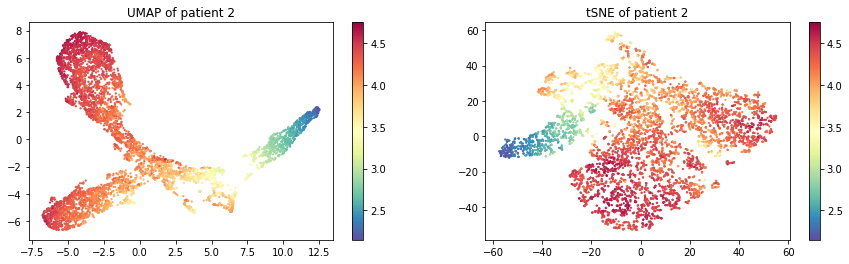

In [36]:
side_by_side(tsne,umap,df2,log_norm_df,'patient 2')

In [209]:
slice1 = [x for x in umap.index if x[0]=='A']
slice2 = [x for x in umap.index if x[0]=='B']

Text(0.5, 1.0, 'RNA Sample Overlay')

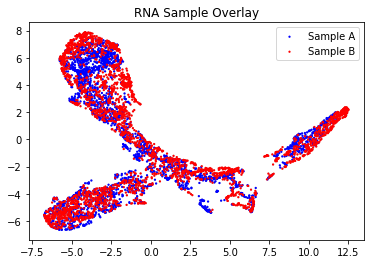

In [38]:
plt.scatter(umap['x'],umap['y'],s=5, edgecolors='none',color='lightgrey')
plt.scatter(umap.loc[slice1]['x'],umap.loc[slice1]['y'],s=5, edgecolors='none',color='blue',label='Sample A')
plt.scatter(umap.loc[slice2]['x'],umap.loc[slice2]['y'],s=5, edgecolors='none',color='red',label='Sample B')
plt.legend()
plt.title('RNA Sample Overlay')

### Summary from raw RNA data visualization

because there is a lot of overlap with the two samples, we do not need to run batch correction. We will now move on to adding in the visium spatial data in AnnData form through Scanpy. This will aid in visualizations througout the unsupervised and semi-supervised methods. 

# Adding in the spatial data

In [233]:
def filter_AD_cells(slice_num,barcode_df,AD,letter):
    pd_barcodes =list(barcode_df.loc[slice_num]['barcode'])
    ad_barcodes= list(AD.obs.index.values)
    
    null_barcodes=[]
    null_idx=[]
    for barcode in pd_barcodes:
        if not barcode in ad_barcodes:
            null_barcodes.append(barcode)
            null_idx.append(barcode_df.index[barcodes['barcode'] == barcode].tolist())
    for x in null_barcodes:
        pd_barcodes.remove(x)
        for item in null_idx:
            for idx in item:
                if idx.split('_')[0]==letter:
                    slice_num.remove(idx)
    ad=AD[pd_barcodes]
    return ad,slice_num

In [217]:
sampleA_path = '/Users/lauren_friend/Desktop/AziziLab/spatial_visium/spatial_2A' #path to directory with 'spatial' file
sampleA_count = '10778_MICHELLE_0212_AHJTWTDRXX__Project_10778__Sample_Patient2A_021120_IGO_10778_3_outs_filtered_feature_bc_matrix.h5'
adA = scanpy.read_visium(path=sampleA_path, count_file = sampleA_count, library_id='2A')
adA.var_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [218]:
sampleB_path = '/Users/lauren_friend/Desktop/AziziLab/spatial_visium/spatial_2B' #path to directory with 'spatial' file
sampleB_count = '10778_MICHELLE_0212_AHJTWTDRXX__Project_10778__Sample_Patient2B_021120_IGO_10778_4_outs_filtered_feature_bc_matrix.h5'
adB = scanpy.read_visium(path=sampleB_path, count_file = sampleB_count, library_id='2B')
adB.var_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [234]:
#adA,slice1=filter_AD_cells(slice1,barcodes,adA,'A')
adB,slice2=filter_AD_cells(slice2,barcodes,adB,'B')

In [231]:
adA=adA[barcodes.loc[slice1]['barcode']]

In [236]:
adB=adB[barcodes.loc[slice2]['barcode']]

In [251]:
updated_index =barcodes.loc[slice1+slice2].index

In [250]:
ad_log_norm_df=log_norm_df.loc[barcodes.loc[slice1+slice2].index]

# Clustering

In [96]:
import random
color_set = pd.Series(list(sns.color_palette('hls', 15)))
random.shuffle(color_set)

def make_clusters(pca_proj,k,norm_df):
    communities, graph, Q = phenograph.cluster(pca_proj, k=k)
    communities = pd.Series(communities, index=norm_df.index)
    print(f'number of clusters: {max(communities)}')
    return communities

def visualize_clusters(cluster_results,tsne):
    fig = plt.figure(figsize=[5*4, 7*4])
    for i, cluster in enumerate(set(cluster_results)):
        cells = cluster_results.index[cluster_results == cluster]
        ax = fig.add_subplot(7, 5, i+1)
        ax.scatter(tsne['x'], tsne['y'], 
            s=3, edgecolors='none', color='lightgrey')        
        ax.scatter(tsne.loc[cells, 'x'], tsne.loc[cells,'y'], 
            s=5, edgecolors='none')
        ax.set_axis_off()
        ax.set_title(cluster)
        sns.despine()
    fig.suptitle("PhenoGraph Clustering, Combined Samples",fontsize=30)

        
def cluster_overlay(cluster_results,tsne):
    fig, ax = plt.subplots(1,1, figsize=(5,4))
    for i, cluster in enumerate(set(cluster_results)):
        cells = cluster_results.index[cluster_results == cluster]
        #plot with a different color for each cluster
        ax.scatter(tsne.loc[cells, 'x'], tsne.loc[cells,'y'], 
                s=12,edgecolors='none', label=cluster, color=color_set[cluster])
        # Clean up
        ax.set_axis_off()
        sns.despine()

    leg = fig.legend(loc=1, markerscale=3,ncol=3)
    bb= leg.get_bbox_to_anchor().inverse_transformed(ax.transAxes)
    xOffset = .5
    bb.x0 += xOffset
    bb.x1 += xOffset
    leg.set_bbox_to_anchor(bb, transform = ax.transAxes)
    fig.suptitle("PhenoGraph Clustering, Combined Samples")
    fig.tight_layout()

In [252]:
clusters=make_clusters(pca_projections.loc[updated_index],90,log_norm_df.loc[updated_index])

Finding 90 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.1691579818725586 seconds
Jaccard graph constructed in 3.9640989303588867 seconds
Wrote graph to binary file in 1.770845890045166 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.776821
After 2 runs, maximum modularity is Q = 0.783802
Louvain completed 22 runs in 3.9157960414886475 seconds
PhenoGraph complete in 9.88651990890503 seconds
number of clusters: 9


<ipython-input-96-bd57e34113b0>:38: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bb= leg.get_bbox_to_anchor().inverse_transformed(ax.transAxes)


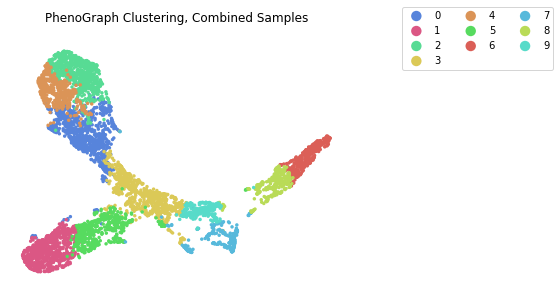

In [253]:
cluster_overlay(clusters,umap.loc[updated_index])

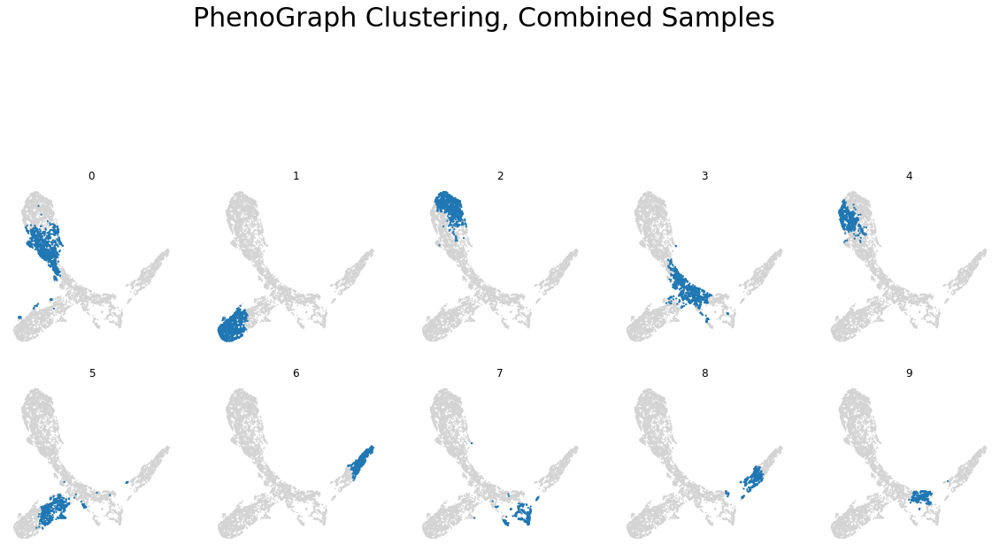

In [255]:
visualize_clusters(clusters,umap.loc[updated_index])

In [295]:
def cluster_AD(cluster_results,AD,slice_num):
    AD.obs['clusters']=[str(x) for x in cluster_results.loc[slice_num]]

In [296]:
cluster_AD(clusters,adA,slice1)
cluster_AD(clusters,adB,slice2)

<AxesSubplot:title={'center':'sample B'}, xlabel='spatial1', ylabel='spatial2'>

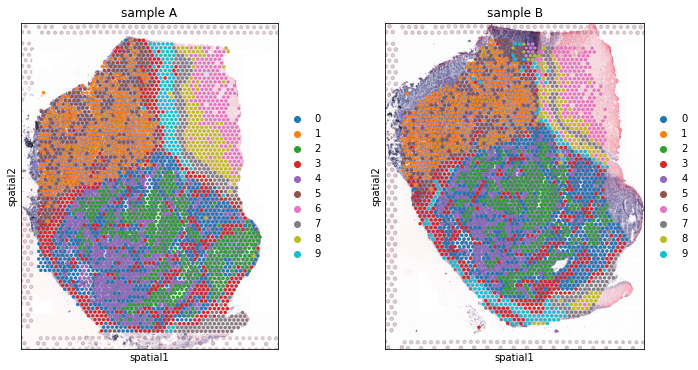

In [302]:
fig, ax = plt.subplots(1,2, figsize=(12,6))
scanpy.pl.spatial(adA,img_key="hires",ax=ax[0],color=['clusters'],size=1.2,
                  title='sample A',show=False,color_map=matplotlib.cm.Spectral_r)
scanpy.pl.spatial(adB,img_key="hires",ax=ax[1],color=['clusters'],size=1.2,
                  title='sample B',show=False, color_map=matplotlib.cm.Spectral_r)

In [374]:
scanpy.tl.rank_genes_groups(adA, "clusters", method="t-test")

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:404: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (


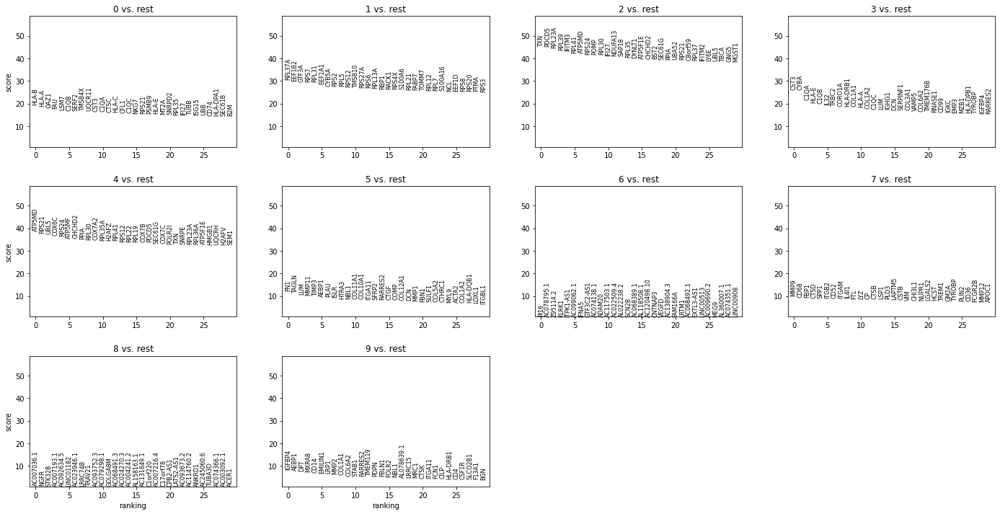

In [375]:
adA_diffexp = scanpy.pl.rank_genes_groups(adA, n_genes=30)

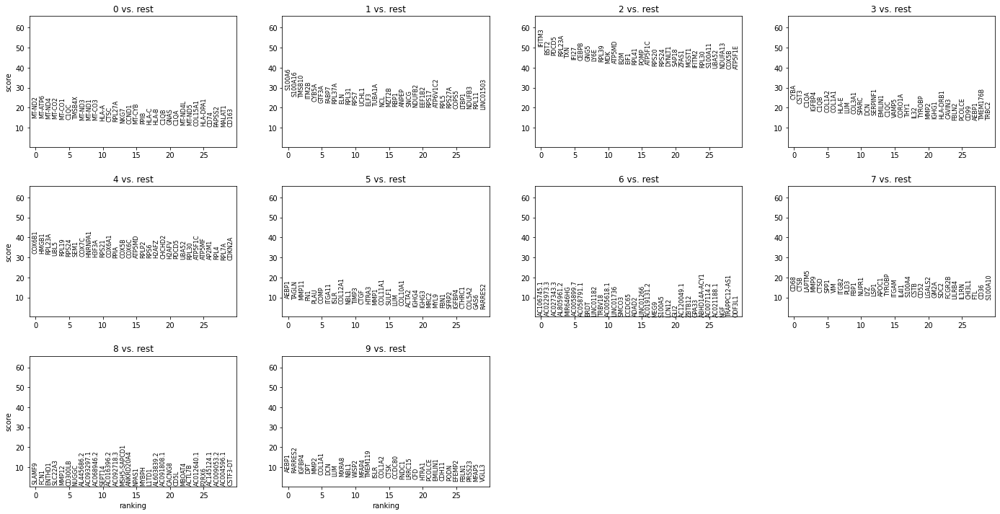

In [376]:
scanpy.tl.rank_genes_groups(adB, "clusters", method="t-test")
adB_diffexp = scanpy.pl.rank_genes_groups(adB, n_genes=30)

In [488]:
def triplicate_vis(ad1,ad2,ad_color_key,umap,umap_color_key,colorbar=False):
    fig, ax = plt.subplots(1,3, figsize=(20,6))
    scanpy.pl.spatial(ad1,img_key="hires",ax=ax[0],color=[ad_color_key],size=1.2,
                      title=f'sample A {ad_color_key}',show=False,color_map=matplotlib.cm.viridis)
    scanpy.pl.spatial(ad2,img_key="hires",ax=ax[1],color=[ad_color_key],size=1.2,
                      title=f'sample B {ad_color_key}',show=False, color_map=matplotlib.cm.viridis)
    plt1=ax[2].scatter(umap['x'],umap['y'],s=5, edgecolors='none',
                      cmap=matplotlib.cm.viridis,c=umap_color_key)
    ax[2].set_title(f'UMAP of combined samples {ad_color_key}')
    if colorbar==True:
        fig.colorbar(plt1,ax=ax[2])
    fig.savefig('/Users/lauren_friend/Desktop/AziziLab/final_proj_figs/'+ad_color_key)

# Semi-Supervised

## Coloring by mitochondrial gene expression

In [304]:
mitochondrial_genes = [x for x in df2.columns.values if x[:3]=='MT-']

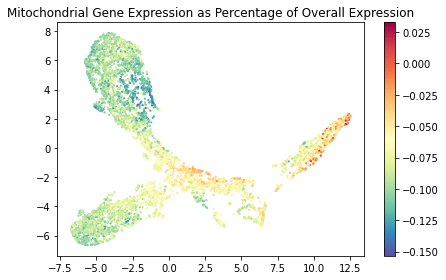

In [305]:
plt.scatter(umap['x'],umap['y'],s=5, edgecolors='none',
                cmap=matplotlib.cm.Spectral_r, c=(log_norm_df[mitochondrial_genes].sum(axis=1) / log_norm_df.sum(axis=1))*100)
plt.colorbar()
plt.title('Mitochondrial Gene Expression as Percentage of Overall Expression')
plt.tight_layout()

So, the combination of the higher percentage of mitochondrial expression and the lower overall expression leads to suport the hypothesis that the smaller island here contains cells undergoing apoptosis

## Breast Tumor Geneset

In [315]:
previous = ['PIK3CA', 'PTEN', 'AKT1', 'TP53', 'GATA3', 'CDH1', 'RB1', 'MLL3', 'MAP3K1', 'CDKN1B']
novel = ['TBX3', 'RUNX1', 'CBFB', 'AFF2', 'PIK3R1', 'PTPN22', 'PTPRD', 'NF1', 'SF3B1', 'CCND3']
breast_tumors = ['ESR1', 'GATA3', 'FOXA1', 'CTCF','XBP1', 'MYB', 'FGFR4', 'EGFR', 'HER2', 'GRB7',
                 'PAM50','ER','PR','HER','ERBB2','TP53','PIK3CA','CDH1','GATA3','MYB','MAP3K1',
                 'EGFR', 'PTPN22', 'PTPRD']
deletions = ['PTEN','TP53','MAP2K4','RB1']

full_set = list(set(previous+novel+breast_tumors+deletions))
full_set =[x for x in full_set if x in log_norm_df.columns]

In [322]:
def gene_expression_AD(col_name,appending_array,AD,slice_num):
    AD.obs[col_name]=[x for x in appending_array.loc[slice_num]]

In [325]:
gene_expression_AD('breast_tumors',log_norm_df[full_set].sum(axis=1),adA,slice1)
gene_expression_AD('breast_tumors',log_norm_df[full_set].sum(axis=1),adB,slice2)

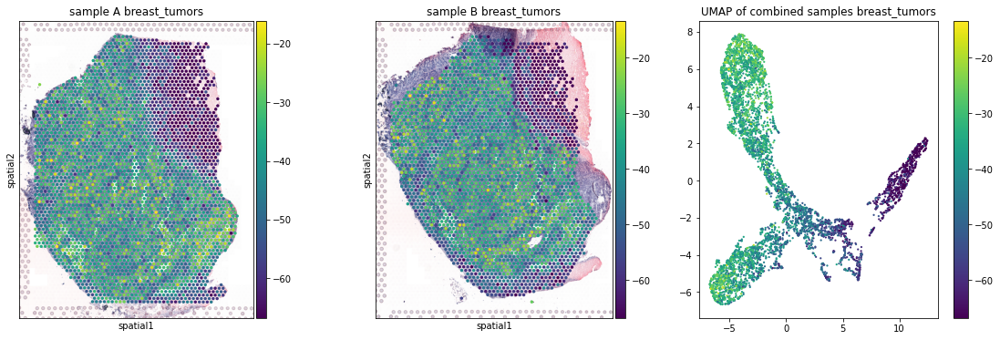

In [489]:
umap_color_key=log_norm_df.loc[updated_index][full_set].sum(axis=1)
triplicate_vis(adA,adB,'breast_tumors',umap.loc[updated_index],umap_color_key,colorbar=True)

Genes not in set: {'HER', 'ER', 'PAM50', 'HER2', 'PR'}


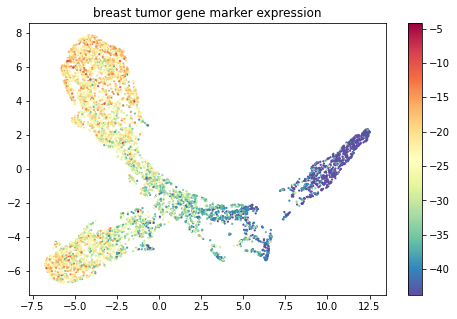

In [307]:
plt.figure(figsize=(8,5))
try:
    plt.scatter(umap['x'],umap['y'],s=5, edgecolors='none',
                    cmap=matplotlib.cm.Spectral_r, c=log_norm_df[breast_tumors].sum(axis=1))
    plt.colorbar()
except KeyError:
    new_genes = [x for x in breast_tumors if x in log_norm_df.columns]
    plt.scatter(umap['x'],umap['y'],s=5, edgecolors='none',
                    cmap=matplotlib.cm.Spectral_r, c=log_norm_df[new_genes].sum(axis=1))
    plt.colorbar()
    plt.title('breast tumor gene marker expression')

    print('Genes not in set:',set(breast_tumors)-set(new_genes))

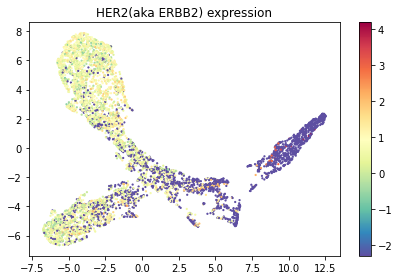

In [308]:
plt.scatter(umap['x'],umap['y'],s=5, edgecolors='none',
                cmap=matplotlib.cm.Spectral_r, c=log_norm_df['ERBB2'])
plt.colorbar()
plt.title('HER2(aka ERBB2) expression')
plt.tight_layout()

<ipython-input-33-0b19ec4c567d>:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = fig.add_subplot(nrows, ncols, i+1)


Genes not in set: ['PR', 'HER', 'MLL3', 'ER', 'PAM50', 'HER2']


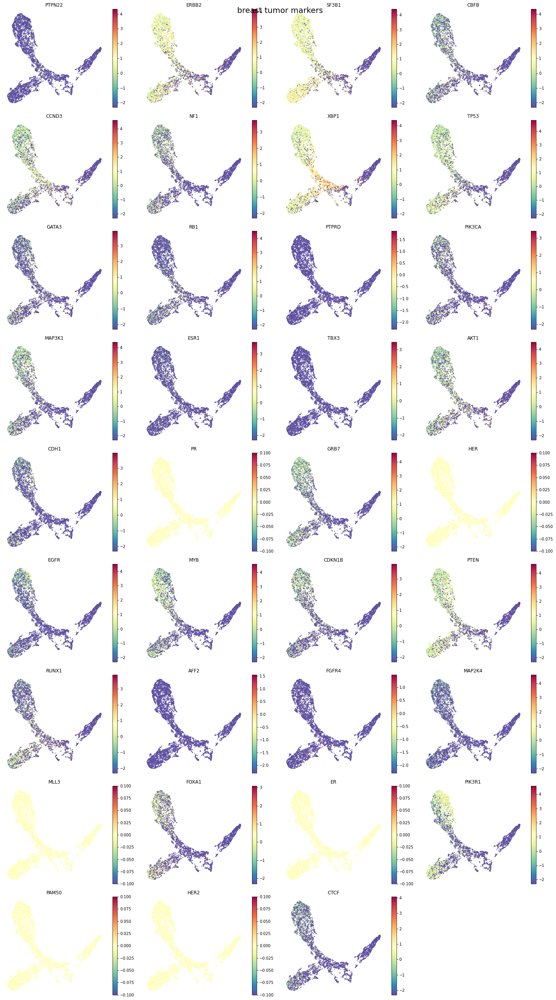

In [309]:
plot_genes_umap(full_set,umap,log_norm_df,'breast tumor markers')

<ipython-input-33-0b19ec4c567d>:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = fig.add_subplot(nrows, ncols, i+1)


Genes not in set: ['MLL3']


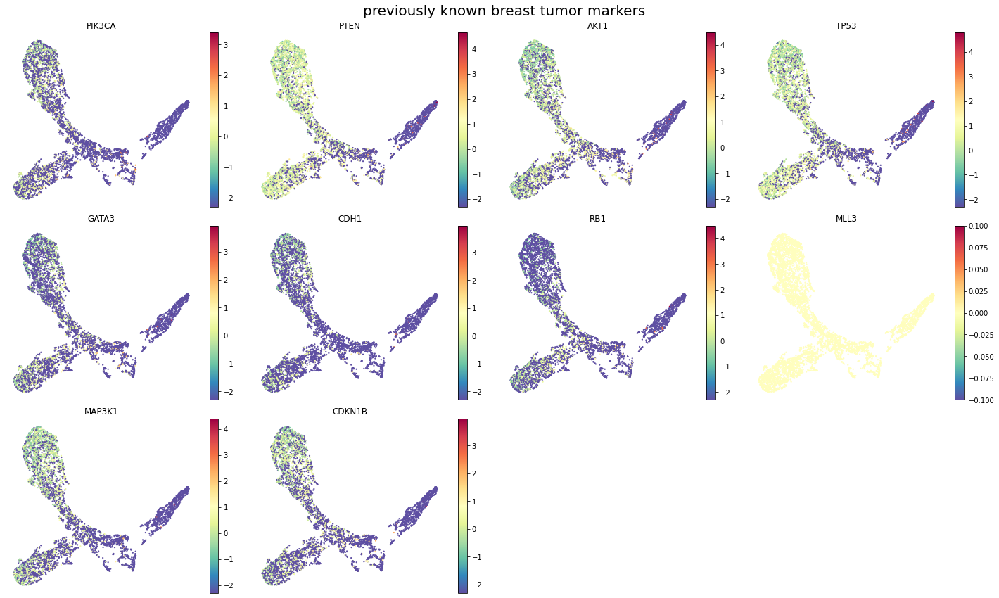

In [310]:
plot_genes_umap(previous,umap,log_norm_df,'previously known breast tumor markers')

Genes not in set: []


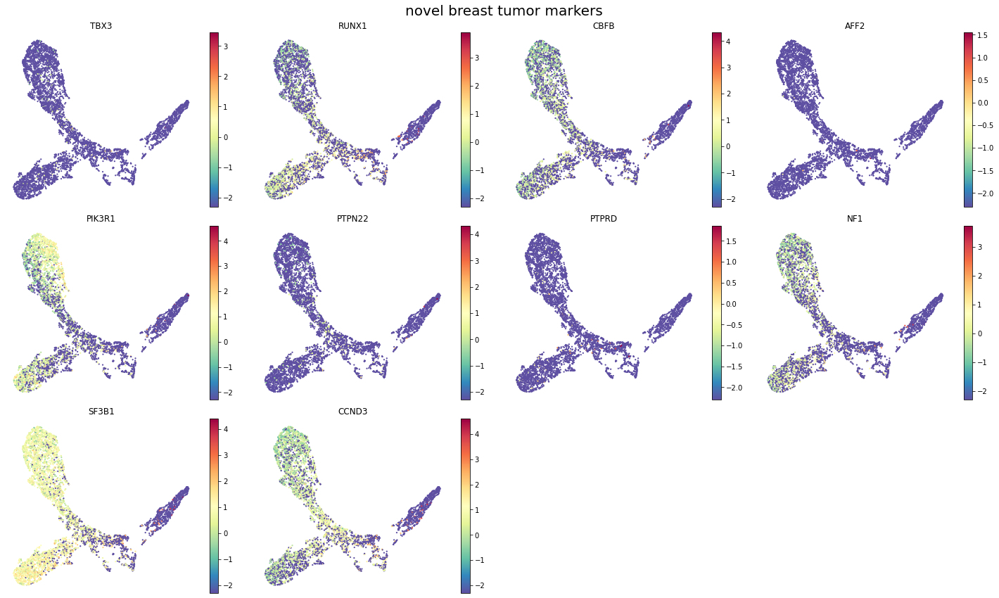

In [311]:
plot_genes_umap(novel,umap,log_norm_df,'novel breast tumor markers')

Genes not in set: []


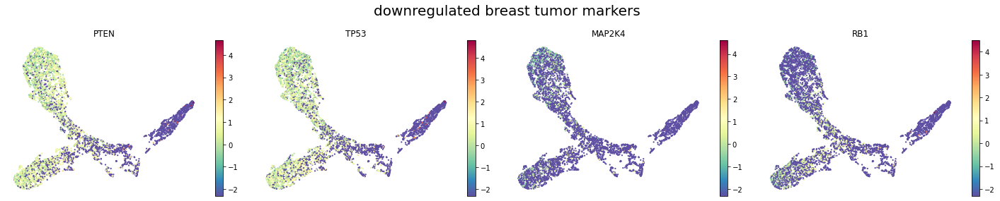

In [312]:
plot_genes_umap(deletions,umap,log_norm_df,'downregulated breast tumor markers')

## Immune cell Genesets

In [335]:
#Immune Cell Gene Markers 
with open(f'{path}/cell_markers.csv') as f:
    lis = [line.split() for line in f]
    
myloid=lis[0][0].split(',')[1:10]
NK= [x for x in lis[1][0].split(',') if x !=''][1:]
macrophage = [x for x in lis[2][0].split(',') if x !=''][1:]
Bcells=[x for x in lis[3][0].split(',') if x !=''][1:]
m1_macrophage_polarization = [x for x in lis[4][2].split(',') if x !=''][1:]
m2_macrophage_polarization = [x for x in lis[5][2].split(',') if x !=''][1:]
erythroblasts=['CD71']
hsc = [x for x in lis[10][0].split(',') if x !=''][1:]
endothelial = [x for x in lis[11][2].split(',') if x !=''][1:]
t = ['CD3D','CD3E']
proliferation = ['MKI67']
treg = ['FOXP3']
fibroblast = ['VIM', 'ACTA2', 'SERPINH1', 'S100A4']
breast_tumor_cels = full_set

gene_list=myloid+NK+macrophage+ Bcells+m1_macrophage_polarization+m2_macrophage_polarization+erythroblasts+hsc+endothelial+t+proliferation+treg+fibroblast
gene_categories = [myloid,NK,macrophage,Bcells,m1_macrophage_polarization,m2_macrophage_polarization,
                   erythroblasts,hsc,endothelial,t,proliferation,treg,fibroblast,breast_tumor_cels]
gene_categories_names = ['myloid','NK','macrophage','Bcells','m1_macrophage_polarization',
                         'm2_macrophage_polarization','erythroblasts','hsc','endothelial',
                         't','proliferation','treg','fibroblast','breast_tumor_cels']

#gene_categories =[x for x in gene_categories if x in log_norm_df.columns]

<ipython-input-336-535f9842128e>:13: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = fig.add_subplot(nrows, ncols, i+1)


Genes not in set: {'HER', 'EGFR', 'CTCF', 'MYB', 'PTPN22', 'ERBB2', 'FGFR4', 'XBP1', 'TP53', 'GATA3', 'PTPRD', 'PIK3CA', 'FOXA1', 'MAP3K1', 'ESR1', 'ER', 'PAM50', 'HER2', 'CDH1', 'PR', 'GRB7'}


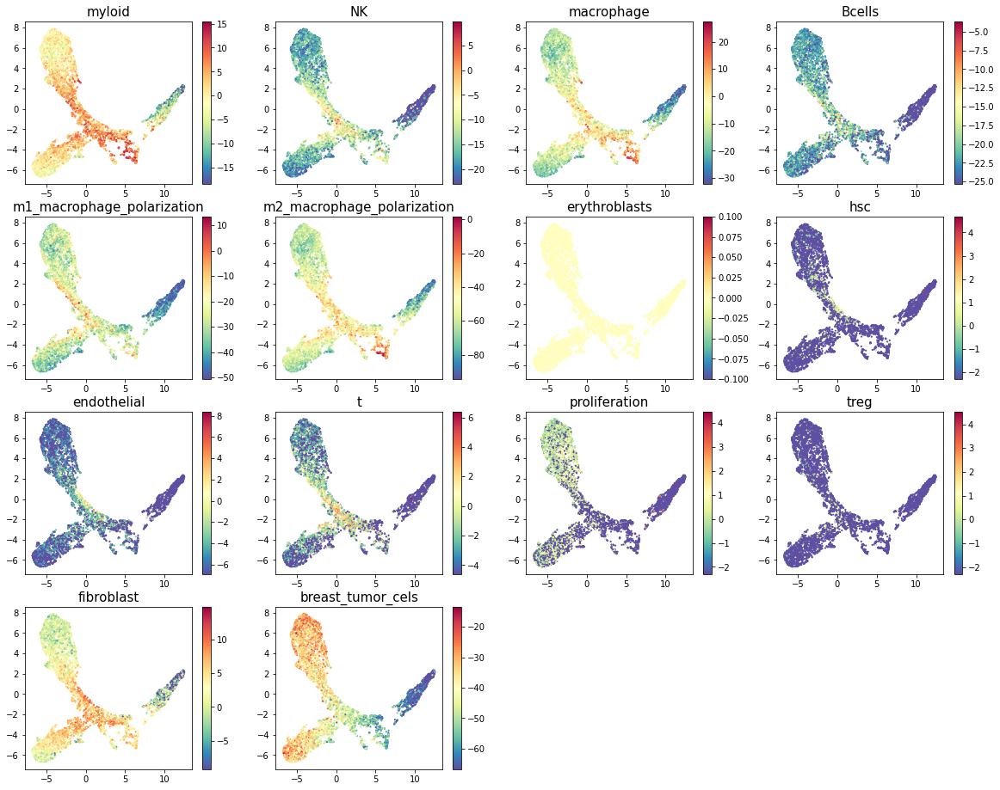

In [336]:
n = len(gene_categories); max_cols = 4
nrows = int(np.ceil(n / max_cols)); ncols = int(min((max_cols, n)))

fig = plt.figure(figsize=[5 * ncols, 4*nrows])
for i, gene in enumerate(gene_categories):
    try:
        ax = fig.add_subplot(nrows, ncols, i+1)
        plot = ax.scatter(umap['x'],umap['y'],s=5, edgecolors='none',
                        cmap=matplotlib.cm.Spectral_r, c=log_norm_df[gene].sum(axis=1))
        fig.colorbar(plot,ax=ax)
        ax.set_title(gene_categories_names[i],fontsize=15)
    except KeyError:
        ax = fig.add_subplot(nrows, ncols, i+1)
        new_genes = [x for x in gene if x in log_norm_df.columns]
        plot=ax.scatter(umap['x'],umap['y'],s=5, edgecolors='none',
                        cmap=matplotlib.cm.Spectral_r, c=log_norm_df[new_genes].sum(axis=1))
        fig.colorbar(plot,ax=ax)
        ax.set_title(gene_categories_names[i],fontsize=15)

print('Genes not in set:',set(breast_tumors)-set(new_genes))

In [338]:
for i, gene in enumerate(gene_categories):
    name=gene_categories_names[i]
    new_genes = [x for x in gene if x in log_norm_df.columns]
    umap_color_key=log_norm_df.loc[updated_index][new_genes].sum(axis=1)
    gene_expression_AD(name,umap_color_key,adA,slice1)
    gene_expression_AD(name,umap_color_key,adB,slice2)

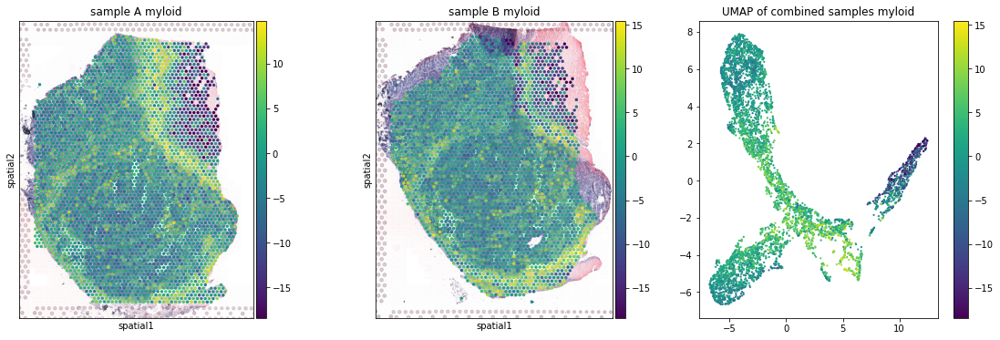

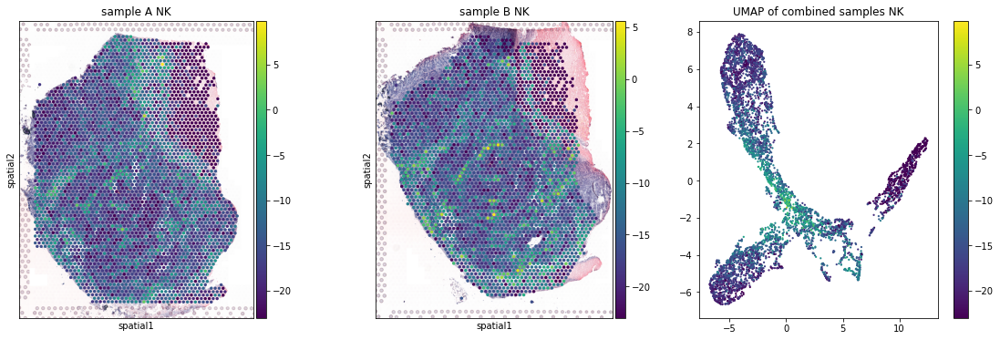

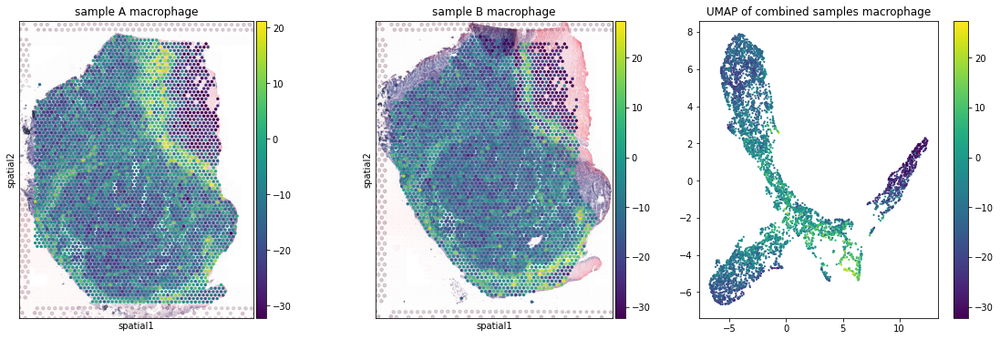

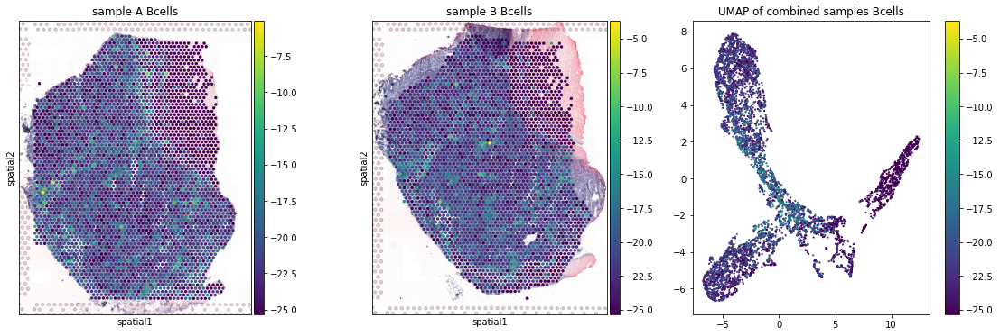

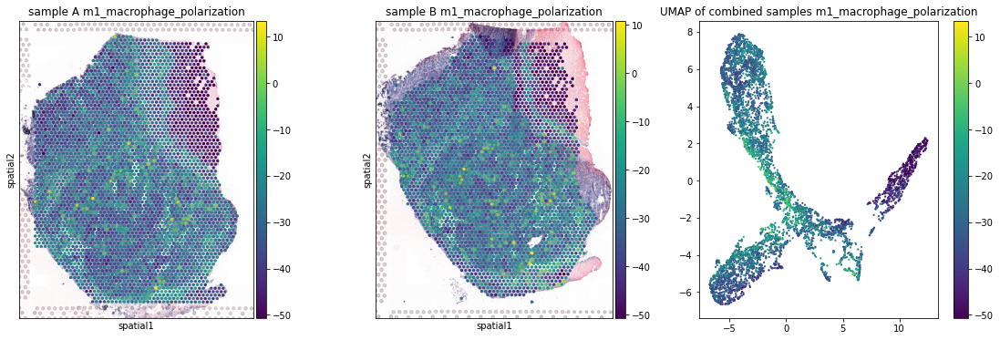

...

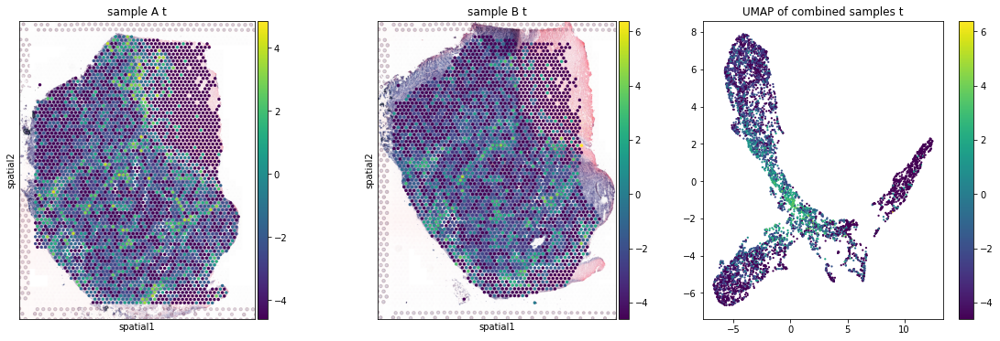

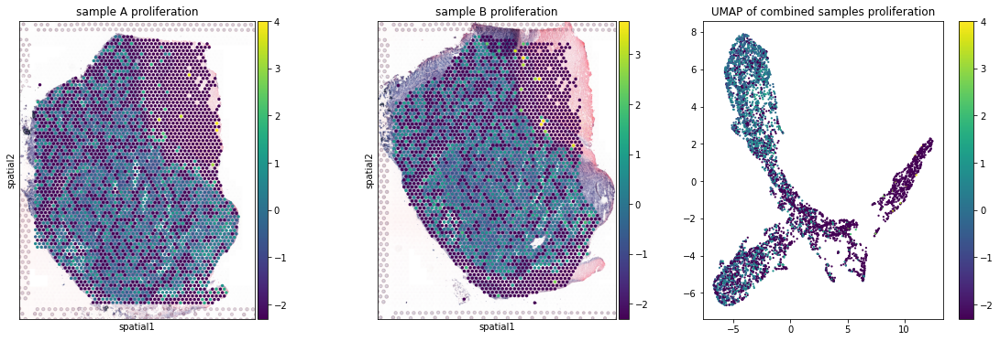

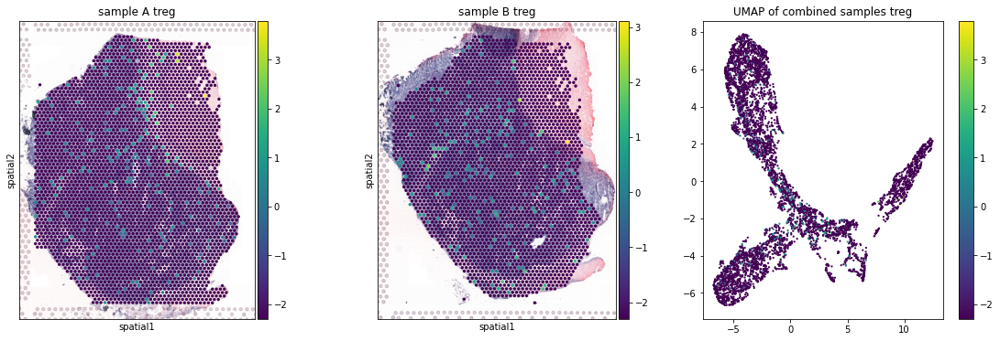

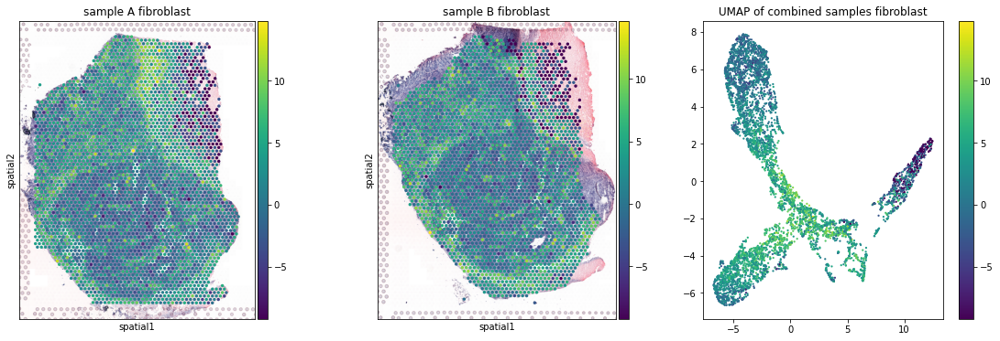

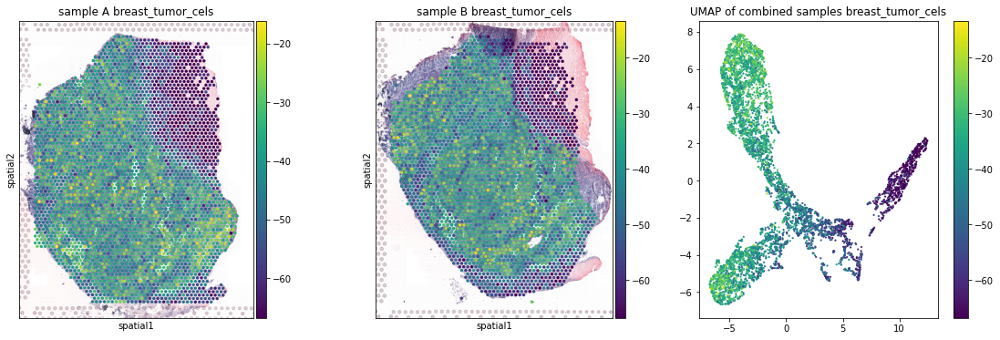

In [563]:
for i, gene in enumerate(gene_categories):
    name=gene_categories_names[i]
    new_genes = [x for x in gene if x in log_norm_df.columns]
    umap_color_key=log_norm_df.loc[updated_index][new_genes].sum(axis=1)
    triplicate_vis(adA,adB,name,umap.loc[updated_index],umap_color_key,colorbar=True)

## Apoptosis colorization

In [344]:
apop_path = '/Users/lauren_friend/Documents/GitHub/comp_bio_final/utilities/geneset.txt'

In [345]:
apoptosis_signatures = []
with open(apop_path, 'r') as GSEAfile:
    for line in GSEAfile:
        apoptosis_signatures.append(line.strip('\n'))

In [346]:
apoptosis_signatures = apoptosis_signatures[2:]

<ipython-input-33-0b19ec4c567d>:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = fig.add_subplot(nrows, ncols, i+1)


Genes not in set: ['CHP2', 'IL3', 'PPP3R2', 'PRKACG']


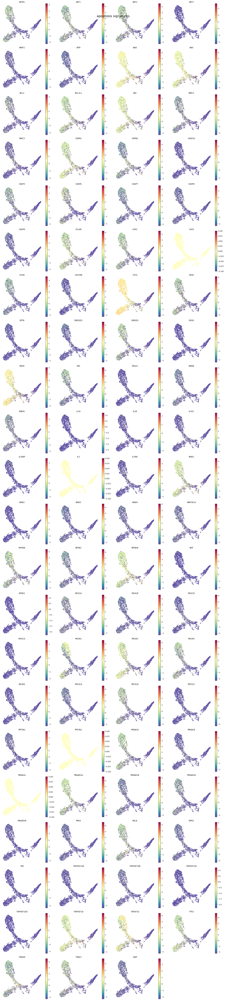

In [347]:
plot_genes_umap(apoptosis_signatures,umap,log_norm_df,'apoptosis signatures')

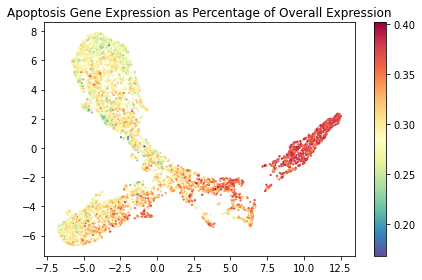

In [348]:
perc_apop = (log_norm_df[(set(apoptosis_signatures)-set(['PPP3R2', 'PRKACG', 'IL3', 'CHP2']))].sum(axis=1) / log_norm_df.sum(axis=1))*100
plt.scatter(umap['x'],umap['y'],s=5, edgecolors='none',
                cmap=matplotlib.cm.Spectral_r, c=perc_apop)
plt.colorbar()
plt.title('Apoptosis Gene Expression as Percentage of Overall Expression')
plt.tight_layout()

In [351]:
gene_expression_AD('apoptosis%',perc_apop.loc[updated_index],adA,slice1)
gene_expression_AD('apoptosis%',perc_apop.loc[updated_index],adB,slice2)

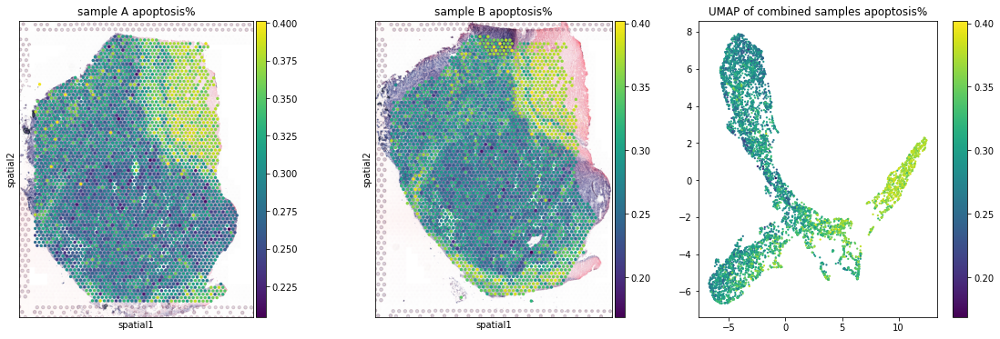

In [561]:
triplicate_vis(adA,adB,'apoptosis%',umap.loc[updated_index],perc_apop.loc[updated_index],colorbar=True)

In [368]:
perc_mit=(log_norm_df.loc[updated_index][mitochondrial_genes].sum(axis=1) / log_norm_df.loc[updated_index].sum(axis=1))*100

In [369]:
gene_expression_AD('mitochondrial%',perc_mit.loc[updated_index],adA,slice1)
gene_expression_AD('mitochondrial%',perc_mit.loc[updated_index],adB,slice2)

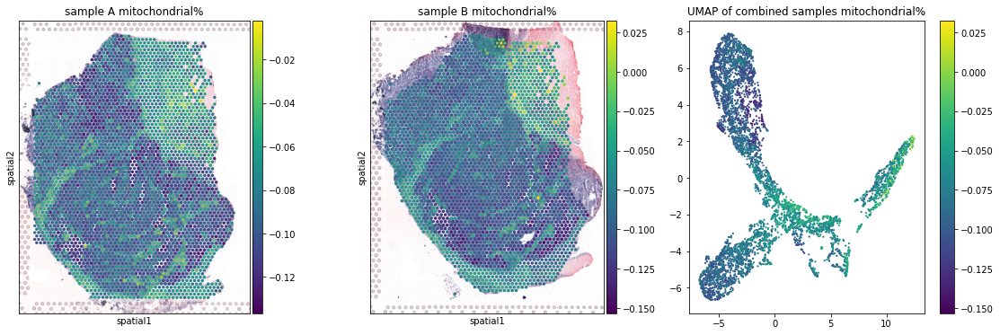

In [562]:
triplicate_vis(adA,adB,'mitochondrial%',umap.loc[updated_index],perc_mit.loc[updated_index],colorbar=True)

# Visualizing the NMF Matricies

In [509]:
W_results={'BC_Wcomp':[8],'NK_Wcomp':[45],'HSC_Wcomp':[49,28, 41],'monocyte_Wcomp':[5,10,25],'endothelial_Wcomp':[29,11,42],
 'B_cell_Wcomp':[7,0,3],'T_cell_Wcomp':[35,6,18,44],'proliferation_Wcomp':[32,46], 'myeloid_Wcomp':[24,1,23]}

In [511]:
file_path = '/Users/lauren_friend/Desktop/AziziLab/NMF_data/'
os.listdir(file_path)

['.DS_Store', '1st send', 'W_rownorm_50comp_DEG.csv']

In [512]:
W_load = np.loadtxt(file_path+'W_rownorm_50comp_DEG.csv')
W = W_load.reshape(1,50, 6446)

In [513]:
W_mtx = pd.DataFrame(W[0].T)

In [514]:
print(W.shape)
print(W_mtx.shape)
W_mtx.head(3)

(1, 50, 6446)
(6446, 50)


,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,0.014663,0.078994,0.026320,0.001866,0.059284,0.029569,0.012845,0.000272,0.00131,0.100878,...,0.028755,0.009575,0.014773,0.018906,0.003237,0.027121,0.004898,0.014528,0.026808,0.013555
1,0.046439,0.053920,0.004202,0.012549,0.054823,0.010430,0.022188,0.004008,0.00660,0.079911,...,0.019671,0.017732,0.034231,0.024556,0.009441,0.023301,0.018632,0.015014,0.026150,0.008503
2,0.133070,0.000496,0.053528,0.239721,0.007451,0.068651,0.030718,0.027138,0.00000,0.035335,...,0.010212,0.020582,0.010219,0.014762,0.017937,0.033708,0.002681,0.013208,0.009579,0.003475


Using Information from @Cameron, Patient A is [0:3244]

In [515]:
W_mtx_A=W_mtx.iloc[0:3244]
W_mtx_B=W_mtx.iloc[3244:]

print(W_mtx_A.shape)
print(W_mtx_B.shape)

(3244, 50)
(3202, 50)


In [521]:
len(slice1)

3206

In [516]:
W_mtx_A.index=[f"A_{i}" for i in np.arange(0,3244)]
W_mtx_B.index=[f"B_{i}" for i in np.arange(0,3202)]
W_mtx.index=list(W_mtx_A.index)+list(W_mtx_B.index)

In [517]:
list(set(slice1)-set(list(W_mtx_A.index.values)))

['A_3244']

In [522]:
list(set(slice2)-set(list(W_mtx_B.index.values)))

[]

In [526]:
shared_idx_A=slice1.remove('A_3244')

In [533]:
shared_idx_A=slice1

In [534]:
shared_idx_B=slice2

In [535]:
shared_idx=list(shared_idx_A)+list(shared_idx_B)

In [536]:
adA=adA[barcodes.loc[shared_idx_A]['barcode']]
adB=adB[barcodes.loc[shared_idx_B]['barcode']]

In [467]:
def add_comp(Wcompnums,col_name):
    W_comp=W_mtx.loc[shared_idx][Wcompnums].sum(axis=1)
    gene_expression_AD(col_name,W_comp,adA,shared_idx_A)
    gene_expression_AD(col_name,W_comp,adB,shared_idx_B)
    return W_comp

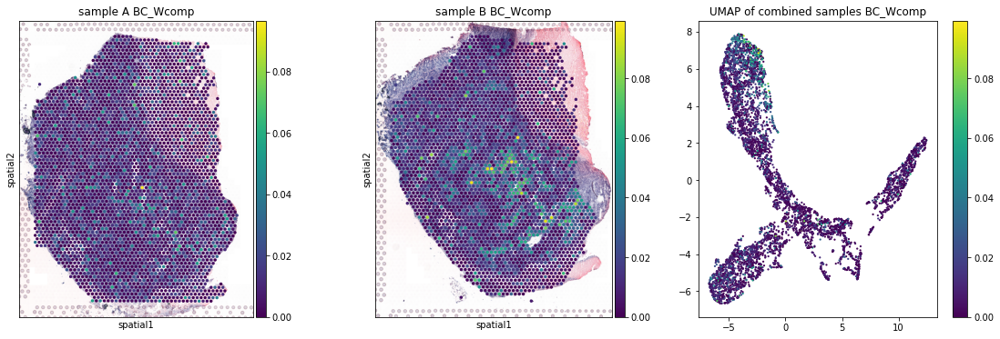

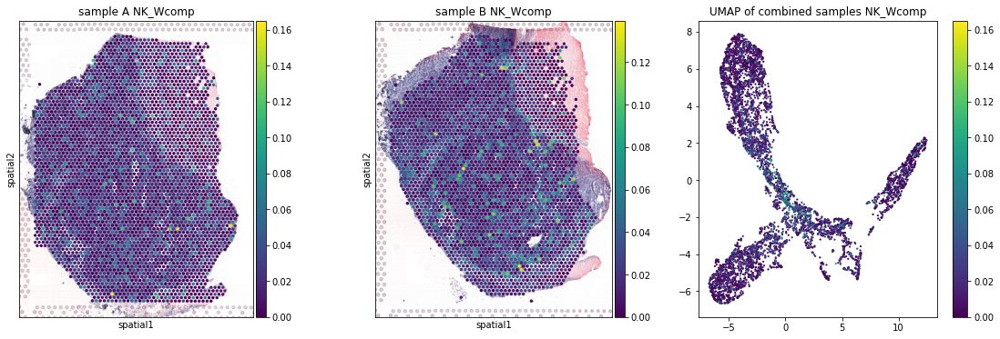

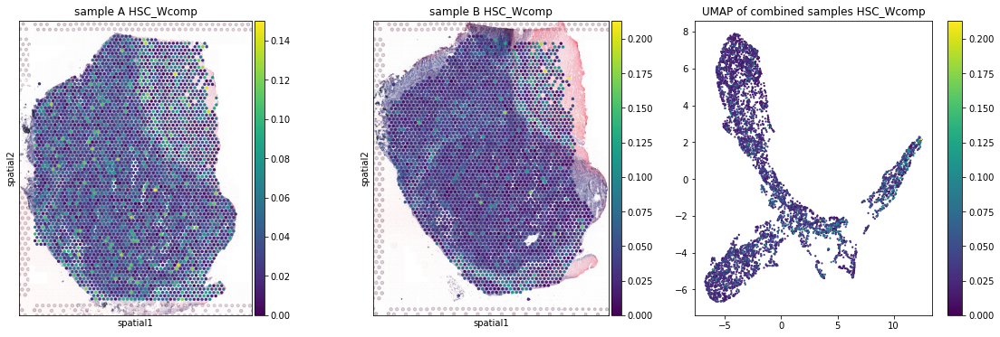

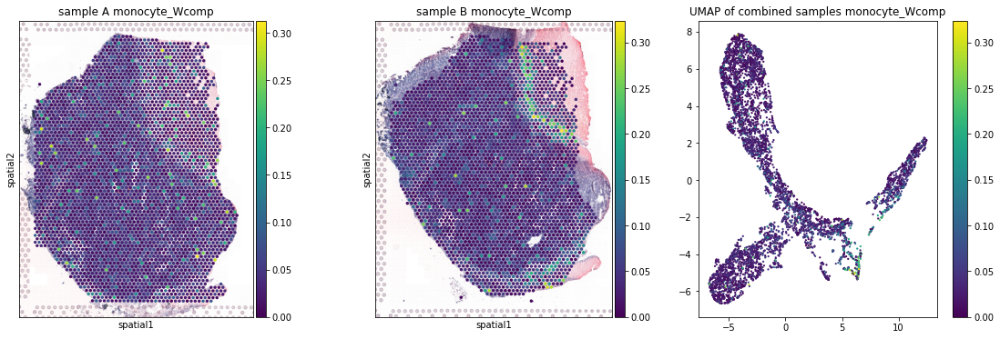

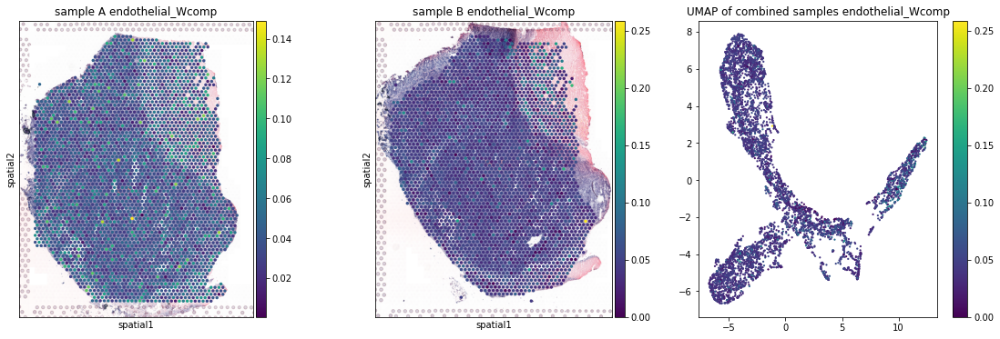

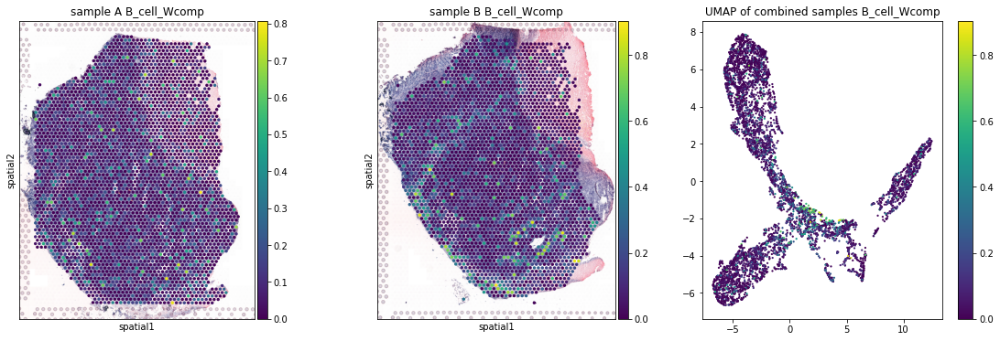

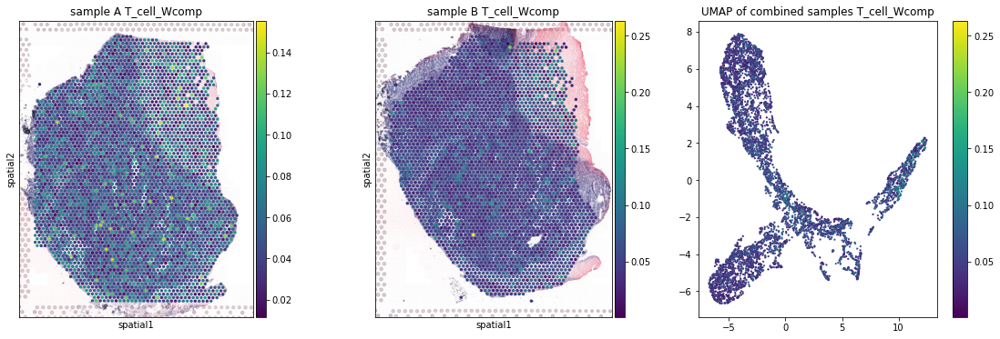

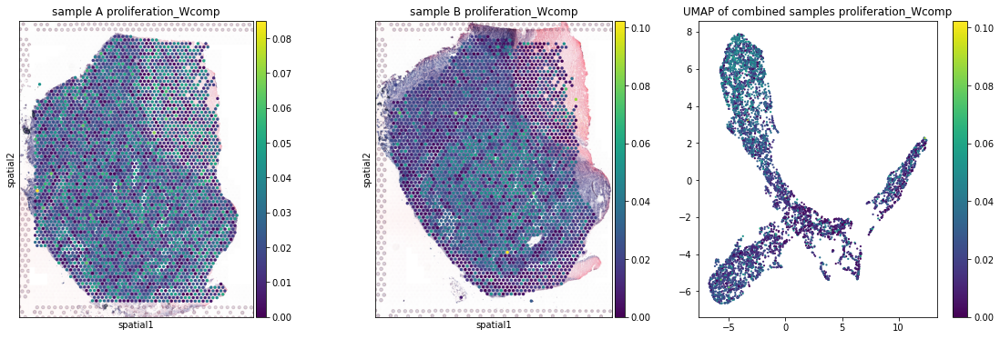

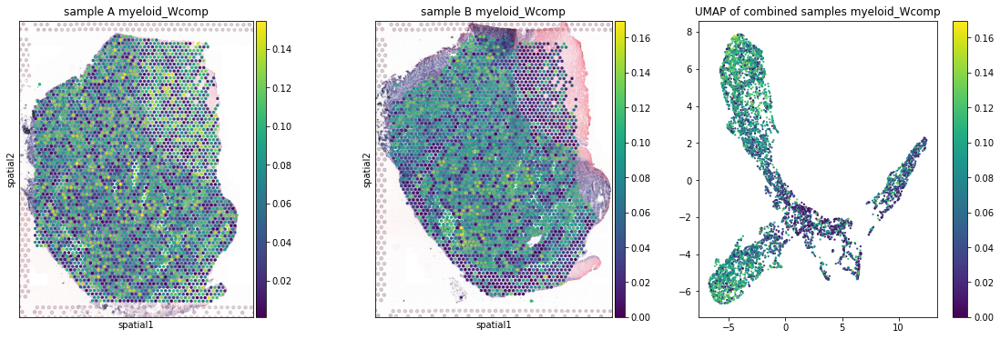

In [542]:
for key in W_results.keys():
    result=add_comp(W_results[key],key)
    triplicate_vis(adA,adB,key,umap.loc[shared_idx],result,colorbar=True)

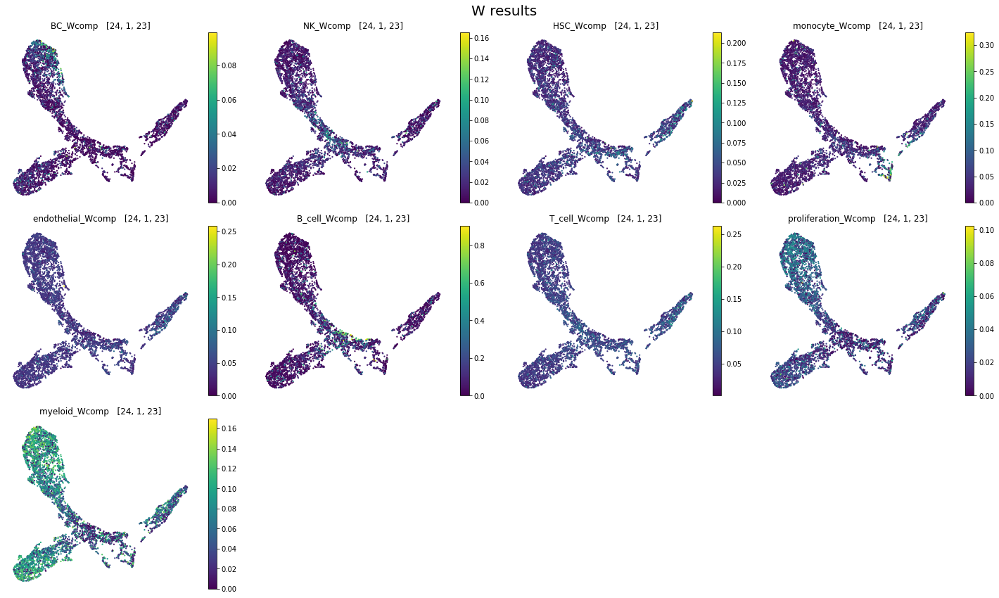

In [560]:
# Set up figure grid
unexpressed=[]
n = len(W_results.keys()); max_cols = 4
nrows = int(np.ceil(n / max_cols)); ncols = int(min((max_cols, n)))

fig = plt.figure(figsize=[5 * ncols, 4*nrows])
for i,key in enumerate(W_results.keys()):
    Wcompnums=W_results[key]
    coloring=W_mtx.loc[shared_idx][Wcompnums].sum(axis=1)
    ax = fig.add_subplot(nrows, ncols, i+1)
    plot = ax.scatter(umap.loc[shared_idx]['x'],umap.loc[shared_idx]['y'],s=5, edgecolors='none',
            cmap=matplotlib.cm.viridis, c=coloring)
    fig.colorbar(plot,ax=ax)
    ax.set_title(key+'   '+str(W_results[x]))
    ax.set_axis_off()
plt.suptitle('W results',fontsize=20)
plt.tight_layout()


In [550]:
W_results.keys()

dict_keys(['BC_Wcomp', 'NK_Wcomp', 'HSC_Wcomp', 'monocyte_Wcomp', 'endothelial_Wcomp', 'B_cell_Wcomp', 'T_cell_Wcomp', 'proliferation_Wcomp', 'myeloid_Wcomp'])